In [1]:
import json
import numpy as np
import os
import pandas as pd
from pyrr import Quaternion, Vector3

from revolve2.modular_robot.body import AttachmentPoint, Module
from revolve2.modular_robot.body.v2 import ActiveHingeV2, BodyV2, BrickV2

from revolve2.ci_group.morphological_measures import MorphologicalMeasures

C:\Users\niels\AppData\Local\Temp\ipykernel_18552\2346033047.py:4: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


In [2]:
def rotate(a: Vector3, b: Vector3, rotation: Quaternion) -> Vector3:
    """
    Rotates vector a a given angle around b.

    :param a: Vector a.
    :param b: Vector b.
    :param rotation: The quaternion for rotation.
    :returns: A copy of a, rotated.
    """
    cos_angle: int = int(round(np.cos(rotation.angle)))
    sin_angle: int = int(round(np.sin(rotation.angle)))

    vec: Vector3 = (
        a * cos_angle + sin_angle * b.cross(a) + (1 - cos_angle) * b.dot(a) * b
    )
    return vec


def vec3_int(vector: Vector3) -> Vector3[np.int_]:
    """
    Cast a Vector3 object to an integer only Vector3.

    :param vector: The vector.
    :return: The integer vector.
    """
    x, y, z = map(lambda v: int(round(v)), vector)
    return Vector3([x, y, z], dtype=np.int64)

def pos2lin(position, shape0):
    return int(position[0] * shape0 + position[1])


In [3]:
def get_body(max_parts, dict_coord):
    # Initialize body
    body = BodyV2()
    v2_core = body.core_v2
    if dict_coord == None:
        return body
    max4grid = max(max_parts, 1)
    position_core = Vector3([max4grid + 2, max4grid + 2, 0], dtype = np.int_)

    # Add all attachment faces to the 'explore_list'
    for idx_attachment, attachment_face in v2_core.attachment_faces.items():
        # Get forward
        if idx_attachment in [0, 2]:
            forward = Vector3([1, 0, 0])
        else:
            forward = Vector3([-1, 0, 0])
        # Get upward, rotation index and absolute rotation
        up = Vector3([0, 0, 1])
        
        # Get all attachment points
        attachment_point_tuples_all = list(attachment_face.attachment_points.items())
        ## Get the min and max values of the attachment points --> used to adapt the core position later on!
        # Offset of attachment points
        att_arr = [] 
        for att in attachment_point_tuples_all:
            transf_off = rotate(att[1].offset,up, att[1].orientation)
            att_arr.append(transf_off)
        att_arr = np.array(att_arr)
        # Min and max values of the attachment points
        min_values = att_arr.min(axis = 0)
        max_values = att_arr.max(axis = 0)

        # Get random attachment points which have not been explored yet
        for attup in attachment_point_tuples_all:
            if attup[0] == 4:
                break

        # Check if forward direction is not vertical
        forward4slot = rotate(forward, up, attup[1].orientation)

        # Get relative location of slot within face
        middle = np.mean([min_values, max_values], axis = 0)
        divider = (max_values - middle) # maximum slot location - middle, both are transformed already
        divider[divider == 0] = 1 # To prevent division by zero
        offset_pos = rotate(attup[1].offset, up, attup[1].orientation) # Transform offset
        rellocslot_raw = (offset_pos - middle)
        rellocslot = (rellocslot_raw / divider) # to -1, 0, 1
        # Add 1 additional for forward position --> 3 x 3 x 3 core instead of 1 x 1 x 1
        rellocslot = forward4slot + rellocslot

        poslin_current = pos2lin(position_core + rellocslot, max4grid * 2 + 4)

        if poslin_current not in dict_coord.keys():
            continue
        modules = {poslin_current: {"module": attachment_face, "position": position_core, "forward": forward, "up": up}}
        tuples2cons = [att for att in attachment_point_tuples_all if att[0] in list(dict_coord[poslin_current][1].keys())]
        modules[poslin_current]["tuples"] = tuples2cons
        current_module = modules[poslin_current]
        
        while len(modules) != 0:
            # ---- Get attachment tuple
            attup = current_module["tuples"][0]

            # ---- Rotate vector a given angle around b, required due to change of orientation
            forward = rotate(current_module["forward"], current_module["up"], attup[1].orientation)

            # ---- Calculate new position
            position = vec3_int(current_module["position"] + forward + rellocslot) 
            #print(position)
            poslin = pos2lin(position, max4grid * 2 + 4)
            #print(poslin)

            # Get child type and rotation index
            child_type = BrickV2 if dict_coord[poslin][0] == "B" else ActiveHingeV2

            child_rotation_index = dict_coord[poslin_current][1][attup[0]]

            # ---- Set the new child
            angle = child_rotation_index * (np.pi / 2.0) # Index is 0 | 1 --> 0 pi | 0.5 pi
            child = child_type(angle)
            current_module["module"].set_child(child, attup[0])

            # ---- Rotate the up vector around the forward vector
            up = rotate(current_module["up"], forward, Quaternion.from_eulers([angle, 0, 0]))

            # ---- Store foreward and up vector
            tuples2cons = [att for att in list(child.attachment_points.items())
                        if att[0] in list(dict_coord[poslin][1].keys())]
            if tuples2cons != []:
                modules[poslin] = {"module": child, "position": position, 
                                   "forward": forward, "up": up, "tuples": tuples2cons}
            else:
                del dict_coord[poslin]

            # ---- Delete the attachment point
            current_module["tuples"] = current_module["tuples"][1:]

            # ---- Change module?
            if (len(current_module["tuples"]) == 0) and (len(modules) != 1):
                del modules[poslin_current]
                module_list = list(modules.values())
                current_module = module_list[np.random.choice(np.arange(len(module_list)))]
                poslin_current = pos2lin(current_module["position"], max4grid * 2 + 4)
                rellocslot = np.zeros(3, dtype = np.int32)
            elif len(current_module["tuples"]) == 0:
                break
            else: pass

    return body
            

In [4]:
if os.path.exists('C:\\Users\\niels\\OneDrive\\Documenten\\GitHub\\revolve2\\idcounts.csv'):
    df_counts = pd.read_csv('C:\\Users\\niels\\OneDrive\\Documenten\\GitHub\\revolve2\\idcounts.csv')
else: df_counts = pd.DataFrame([], columns = ["id_string"])


if os.path.exists("C:\\Users\\niels\\OneDrive\\Documenten\\GitHub\\revolve2\\morphological_measures.csv"):
    df = pd.read_csv("C:\\Users\\niels\\OneDrive\\Documenten\\GitHub\\revolve2\\morphological_measures.csv")
    # Increase counts of existing ids
    for idx, row in df.iterrows():
        df.loc[idx, "count"] = df_counts.loc[df_counts["id"] == row["id_string"], "count"].values[0]
else: df = pd.DataFrame([], columns = [])

In [5]:
for max_parts in range(1, 21):
    print("Max Parts: ", max_parts)
    with open(f'C:\\Users\\niels\\OneDrive\\Documenten\\GitHub\\revolve2\\{max_parts}.json', 'r') as f:
        data = json.load(f)
        for max_parts, dictparts in data.items():
            # Initialize grid
            for bricks, dictbricks in dictparts.items():
                bricks = int(bricks)
                for hinges, dicthinges in dictbricks.items():
                    for string in dicthinges:
                        if df.empty or (string not in df["id_string"].values): # New string
                            # Get max_parts and substring
                            splitted = string.split("|")
                            max_parts = int(splitted[0])
                            if max_parts == 1:
                                dict_coord = None
                            elif len(splitted) == 2:
                                # Get coordinate data
                                substring = splitted[1]
                                substring_split = substring.split("-")
                                dict_coord = {}
                                i = 0
                                while (i != len(substring_split)) and (substring_split[i] != ""):
                                    coord = int(substring_split[i])
                                    info = substring_split[i + 1]
                                    # Set type
                                    dict_coord[coord] = []
                                    dict_coord[coord].append(info[0])
                                    
                                    if len(info[1:]) > 1:
                                        dict_coord[coord].append({})
                                        for j in range(int((len(info) - 1) / 2)):
                                            dict_coord[coord][1][int(info[1 + int(j * 2)])] = int(info[1 + (int(j * 2) + 1)])
                                    else:
                                        dict_coord[coord].append({})
                                    
                                    i += 2
                            else:
                                raise ValueError("No substring found")
                            # Develop body
                            body = get_body(max_parts, dict_coord)
                            # Get morphological measures
                            morphology = MorphologicalMeasures(body = body, brain = np.nan, max_modules = 20)
                            
                            id_string = morphology.id_string
                            assert id_string == string, "ID string not equal to original string!"

                            nbricks = morphology.num_bricks
                            nhinges = morphology.num_active_hinges
                            assert (nhinges + nbricks + 1) == max_parts, "Number of parts not equal to max_parts!"

                            size = morphology.size
                            proportion2d = morphology.proportion_2d

                            single_neighbour_brick_ratio = morphology.single_neighbour_brick_ratio
                            single_neighbour_ratio = morphology.single_neighbour_ratio
                            double_neighbour_brick_and_active_hinge_ratio = morphology.double_neigbour_brick_and_active_hinge_ratio
                            maxrel_llimbs, meanrel_llimbs, stdrel_llimbs = morphology.length_of_limbsNiels
                            
                            joints = morphology.joints
                            joint_brick_ratio = morphology.joint_brick_ratio
                            symmetry = morphology.symmetry
                            coverage = morphology.coverage
                            branching = morphology.branching
                            surface_area = morphology.surface

                            df = pd.concat([df, pd.DataFrame([{ "bricks": nbricks, "hinges": nhinges, "modules": max_parts, "size": size, "proportion2d": proportion2d, 
                                                            "single_neighbour_brick_ratio": single_neighbour_brick_ratio, 
                                                            "single_neighbour_ratio": single_neighbour_ratio, "double_neighbour_brick_and_active_hinge_ratio": double_neighbour_brick_and_active_hinge_ratio, 
                                                            "maxrel_llimbs": maxrel_llimbs, "meanrel_llimbs": meanrel_llimbs, "stdrel_llimbs": stdrel_llimbs,
                                                                "joints": joints, "joint_brick_ratio": joint_brick_ratio, 
                                                            "symmetry": symmetry, "coverage": coverage, "branching": branching, "surface_area": surface_area,
                                                            "id_string": id_string, "count": df_counts.loc[df_counts["id"] == id_string, "count"].values[0]}])],
                                                                ignore_index=True)

                            
df.to_csv("C:\\Users\\niels\\OneDrive\\Documenten\\GitHub\\revolve2\\morphological_measures.csv", index = False)

Max Parts:  1
Max Parts:  2
Max Parts:  3
Max Parts:  4
(4, 4, 3)
16
16


AssertionError: Body is not 2D.

c:\Users\niels\OneDrive\Documenten\GitHub\revolve2\.venv\lib\site-packages\pandas\plotting\_matplotlib\core.py:1345: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  scatter = ax.scatter(


<Axes: xlabel='joint_brick_ratio', ylabel='proportion2d'>

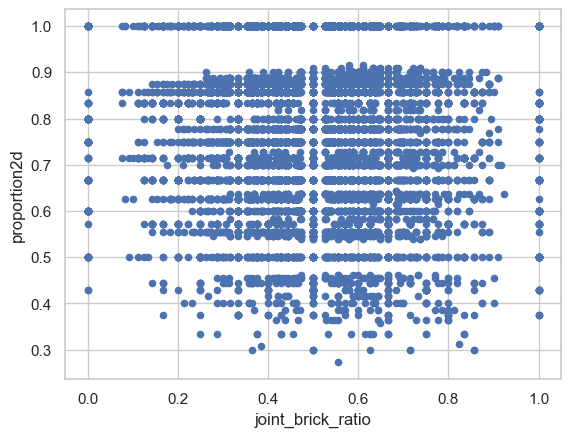

In [ ]:
# df.plot.scatter(x='modules', y='bricks', colormap='viridis')
#df.plot.scatter(x='modules', y='hinges', colormap='viridis')
df.plot.scatter(x='joint_brick_ratio', y="proportion2d", colormap='viridis')
# df.plot.scatter(x='modules', y='brick_hinge_ratio', colormap='viridis')
#df.plot.scatter(x='modules', y='proportion', colormap='viridis')
#df.plot.scatter(x='modules', y='coverage', colormap='viridis')

#df.plot.scatter(x='bricks', y='coverage', colormap='viridis')



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm


def data_coord2view_coord(p, vlen, pmin, pmax):
    dp = pmax - pmin
    dv = (p - pmin) / dp * vlen
    return dv


def nearest_neighbours(xs, ys, reso, n_neighbours):
    im = np.zeros([reso, reso])
    extent = [np.min(xs), np.max(xs), np.min(ys), np.max(ys)]

    xv = data_coord2view_coord(xs, reso, extent[0], extent[1])
    yv = data_coord2view_coord(ys, reso, extent[2], extent[3])
    for x in range(reso):
        for y in range(reso):
            xp = (xv - x)
            yp = (yv - y)

            d = np.sqrt(xp**2 + yp**2)

            im[y][x] = 1 / np.sum(d[np.argpartition(d.ravel(), n_neighbours)[:n_neighbours]])

    return im, extent

def normalize(col):
    return (col - np.min(col)) / (np.max(col) - np.min(col))

xs = normalize(df["joint_brick_ratio"].astype(float))
ys = normalize(df["proportion2d"].astype(float))

def get_resolution(col):
    sorted_diff = col.sort_values().diff()
    min_diff = sorted_diff[sorted_diff > 0].min()
    return int((col.max() - col.min()) / min_diff)

resolution = max(get_resolution(xs), get_resolution(ys)) * 1
#neighbours = int(600 / (250**2) * (resolution**2))
neighbours = 8

if neighbours == 0:
     plt.plot(xs, ys, 'k.', markersize=2)
     plt.title("Scatter Plot")
     plt.grid()
else:
    im, extent = nearest_neighbours(xs, ys, resolution, neighbours)
    #im = np.log(im + 1 * 10**-10)
    plt.imshow(im, origin='lower', extent=extent, cmap=cm.Reds)#jet
    plt.title("Smoothing over %d neighbours" % neighbours)
    plt.xlim(extent[0], extent[1])
    plt.ylim(extent[2], extent[3])
    
# plt.show()

C:\Users\niels\AppData\Local\Temp\ipykernel_20220\2763794903.py:25: FutureWarning: Series.ravel is deprecated. The underlying array is already 1D, so ravel is not necessary.  Use `to_numpy()` for conversion to a numpy array instead.
  im[y][x] = 1 / np.sum(d[np.argpartition(d.ravel(), n_neighbours)[:n_neighbours]])
C:\Users\niels\AppData\Local\Temp\ipykernel_20220\2763794903.py:25: FutureWarning: Series.ravel is deprecated. The underlying array is already 1D, so ravel is not necessary.  Use `to_numpy()` for conversion to a numpy array instead.
  im[y][x] = 1 / np.sum(d[np.argpartition(d.ravel(), n_neighbours)[:n_neighbours]])
C:\Users\niels\AppData\Local\Temp\ipykernel_20220\2763794903.py:25: FutureWarning: Series.ravel is deprecated. The underlying array is already 1D, so ravel is not necessary.  Use `to_numpy()` for conversion to a numpy array instead.
  im[y][x] = 1 / np.sum(d[np.argpartition(d.ravel(), n_neighbours)[:n_neighbours]])
C:\Users\niels\AppData\Local\Temp\ipykernel_20220

KeyboardInterrupt: 

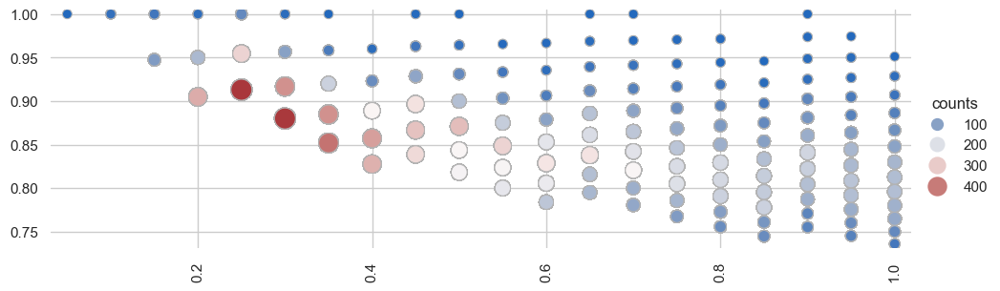

In [ ]:
import seaborn as sns
sns.set_theme(style="whitegrid")

col1 = "size"
col2 = "surface_area"

# Unique counts
df["counts"] = df.groupby([col1, col2]).transform("size")

# Draw each cell as a scatter point with varying size and color
g = sns.relplot(
    data=df,
    x=col1, y=col2, hue="counts", size= "counts",
    palette="vlag", hue_norm=(0, df["counts"].max()), size_norm = (0, df["counts"].max()),
    edgecolor=".7",
    height=10, sizes=(50, 250),
)

# Tweak the figure to finalize
g.set(xlabel="", ylabel="", aspect="equal")
g.despine(left=True, bottom=True)
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(90)


plt.show()